In [1]:
import polars as pl
from datetime import datetime, timezone

df = pl.read_csv("../cache/NVDA_5y_1mo.csv")

df.columns = [col.lower() for col in df.columns]

df = df.with_columns(
    pl.col("date").str.to_datetime().dt.cast_time_unit("ms").dt.replace_time_zone(None).alias("date"),
    pl.col("returns").fill_null(0).alias("returns")
)


start_date = df["date"].min()
end_date = df["date"].max()

df.filter(
    (pl.col("date") >= start_date) & (pl.col("date") <= end_date)
)

date,close,high,low,open,volume,dividends,stock splits,sma_50,macd,signal_line,macd_hist,returns,rsi,bb_lower,bb_upper,roc,hi_lo,hi_close,lo_close,true_range,atr,obv,k,d
datetime[ms],f64,f64,f64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
2020-05-01 00:00:00,8.84292,9.148047,6.995228,7.082656,12548876000,0.0,0.0,null,0.0,0.0,0.0,0.0,null,null,null,null,2.152819,null,null,2.152819,null,null,null,null
2020-06-01 00:00:00,9.462888,9.607106,8.62622,8.800827,9719464000,0.004,0.0,null,0.049456,0.009891,0.039565,0.619967,null,null,null,null,0.980886,0.764186,0.2167,0.980886,null,0.070109,null,null
2020-07-01 00:00:00,10.580613,10.757542,9.382728,9.490132,8094452000,0.0,0.0,null,0.176803,0.043274,0.13353,1.117725,null,null,null,null,1.374814,1.294654,0.08016,1.374814,null,0.188226,null,null
2020-08-01 00:00:00,13.331486,13.53134,10.680788,10.697983,9672544000,0.0,0.0,null,0.494005,0.13342,0.360585,2.750873,null,null,null,null,2.850552,2.950727,0.100175,2.950727,null,0.448217,null,null
2020-09-01 00:00:00,13.486983,14.679386,11.666607,13.436645,15856552000,0.004,0.0,null,0.749299,0.256596,0.492704,0.155498,null,null,null,null,3.012779,1.3479,1.664879,3.012779,null,0.459881,null,null
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
2024-12-01 00:00:00,134.268402,146.516433,126.839604,138.807681,4085855200,0.01,0.0,45.084615,27.944016,23.083541,4.860476,-3.959366,-21.599308,-34.234515,124.403746,384.18176,19.676829,8.288665,11.388164,19.676829,18.944217,3.364249,-12558.177642,-12622.645024
2025-01-01 00:00:00,120.05896,153.115925,116.239311,135.987496,5950612600,0.0,0.0,47.218547,26.704975,23.807828,2.897148,-14.209442,-40.283023,-34.326906,128.763999,217.536959,36.876614,18.847523,18.029091,36.876614,20.053625,3.25842,-12496.523874,-12665.806498
2025-02-01 00:00:00,124.908508,143.426809,112.999608,114.739446,4755230400,0.0,0.0,49.456379,25.816745,24.209611,1.607134,4.849548,-42.701374,-34.367503,133.28026,195.469796,30.427201,23.367849,7.059352,30.427201,21.2435,3.298813,-11490.840332,-12181.847283


In [1]:
import polars as pl

df = pl.read_parquet("../cache/master_news.parquet")

df.columns

['date',
 'headlines',
 'article',
 'title',
 'embeddings',
 'headline_positive_sentiment',
 'headline_neutral_sentiment',
 'headline_negative_sentiment',
 'finbert_positive_sentiment',
 'finbert_neutral_sentiment',
 'finbert_negative_sentiment',
 'sia_positive_sentiment',
 'sia_neutral_sentiment',
 'sia_negative_sentiment',
 'sia_compound_sentiment',
 'finbert_sentiment',
 'sia_sentiment',
 'headline_sentiment']

In [5]:
df.group_by_dynamic("date", every="1mo").agg(
    pl.col("close").sum()
)

date,close
datetime[ms],f64
2020-05-01 00:00:00,8.84292
2020-06-01 00:00:00,9.462888
2020-07-01 00:00:00,10.580613
2020-08-01 00:00:00,13.331486
2020-09-01 00:00:00,13.486983
…,…
2024-12-01 00:00:00,134.268402
2025-01-01 00:00:00,120.05896
2025-02-01 00:00:00,124.908508


In [1]:
import polars as pl

df = pl.read_parquet("../cache/master_news.parquet")

df.columns

['date',
 'headlines',
 'article',
 'title',
 'embeddings',
 'headline_positive_sentiment',
 'headline_neutral_sentiment',
 'headline_negative_sentiment',
 'finbert_positive_sentiment',
 'finbert_neutral_sentiment',
 'finbert_negative_sentiment',
 'sia_positive_sentiment',
 'sia_neutral_sentiment',
 'sia_negative_sentiment',
 'sia_compound_sentiment',
 'finbert_sentiment',
 'sia_sentiment',
 'headline_sentiment']

In [2]:
import cupy as cp

a = cp.array(df["embeddings"])
b = a.copy()

dot_prod = cp.dot(a, b.T)
norm_a = cp.linalg.norm(a, axis=1, keepdims=True)
norm_b = cp.linalg.norm(b, axis=1, keepdims=True)

norm_prod = norm_a @ norm_b.T

del a
del b
del norm_a
del norm_b

cosine_similarity = dot_prod / norm_prod

del dot_prod
del norm_prod

normalized_similarity = (cosine_similarity - cp.mean(cosine_similarity)) / cp.std(cosine_similarity)

print(cosine_similarity)


[[1.         0.91251859 0.84428023 ... 0.78882261 0.87919846 0.78831826]
 [0.91251859 1.         0.84032229 ... 0.76709184 0.88075823 0.7333166 ]
 [0.84428023 0.84032229 1.         ... 0.87671667 0.89248606 0.84196851]
 ...
 [0.78882261 0.76709184 0.87671667 ... 1.         0.8155863  0.78402206]
 [0.87919846 0.88075823 0.89248606 ... 0.8155863  1.         0.80029309]
 [0.78831826 0.7333166  0.84196851 ... 0.78402206 0.80029309 1.        ]]


AttributeError: AxesImage.set() got an unexpected keyword argument 'legend'

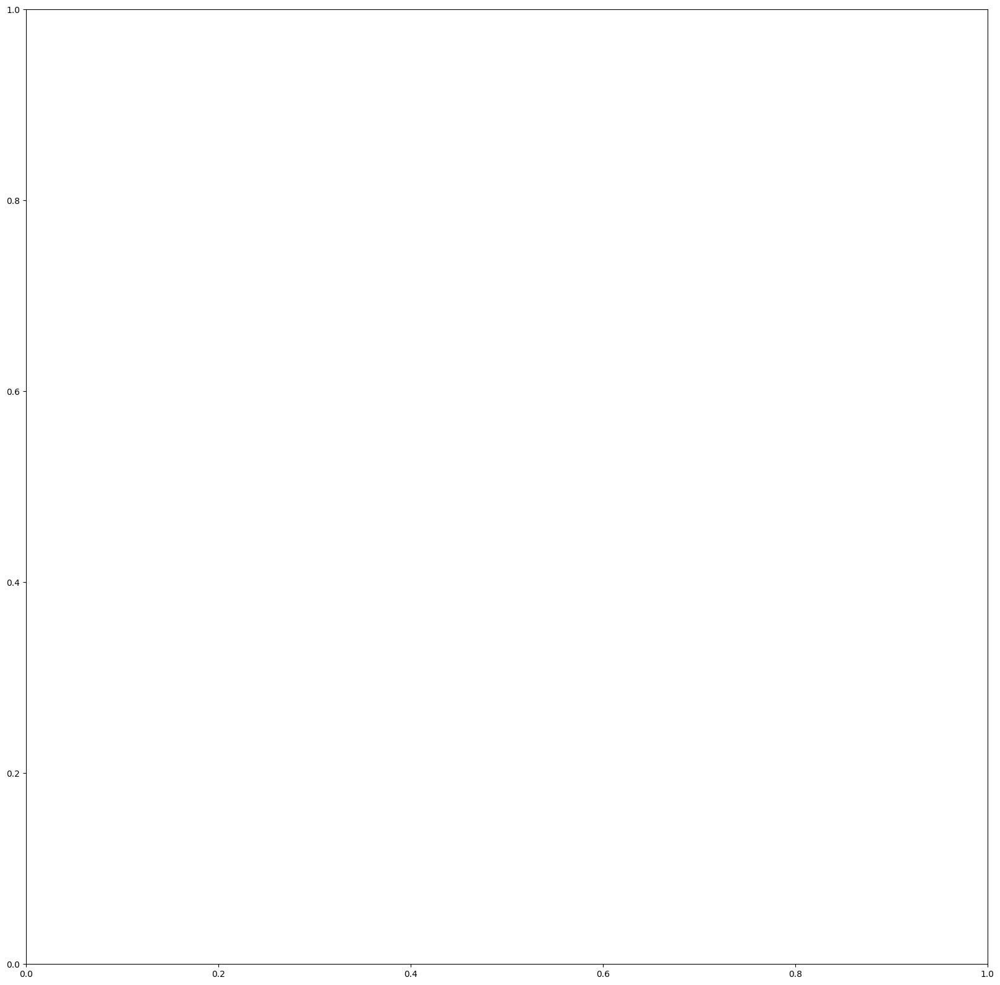

In [ ]:
import matplotlib.pyplot as plt

fig,ax = plt.subplots(figsize=(20,20))

ax.matshow(normalized_similarity.get())

<Axes: >

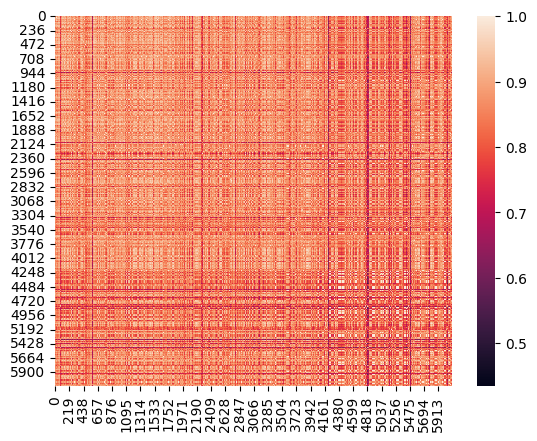

In [ ]:
import seaborn as sns

sns.heatmap(cosine_similarity.get(), ax=ax)

In [2]:
import os
import json
from datetime import datetime

with open(os.path.join("../cache", "master_news.json"), "r") as f:
        data = json.load(f)

raw_date = [date for date in data["articles"].keys()]
dates = [datetime.strptime(date, "%Y-%m-%dT%H:%M:%S") for date in data["articles"].keys()]

values = [i for i in range(len(dates))]

datas = {}

for date, val in zip(raw_date, values):
        datas[date] = val

datas

{'2020-01-08T08:00:00': 0,
 '2020-01-10T08:00:00': 1,
 '2020-01-16T08:00:00': 2,
 '2020-01-15T08:00:00': 3,
 '2020-01-31T08:00:00': 4,
 '2020-01-03T08:00:00': 5,
 '2020-01-27T08:00:00': 6,
 '2020-01-13T08:00:00': 7,
 '2020-01-05T08:00:00': 8,
 '2020-01-06T08:00:00': 9,
 '2020-01-22T08:00:00': 10,
 '2020-01-17T08:00:00': 11,
 '2020-01-29T08:00:00': 12,
 '2020-01-21T08:00:00': 13,
 '2020-01-02T02:30:35': 14,
 '2020-01-23T08:00:00': 15,
 '2020-01-09T08:00:00': 16,
 '2020-01-07T08:00:00': 17,
 '2020-01-14T08:00:00': 18,
 '2020-01-30T08:00:00': 19,
 '2020-01-20T08:00:00': 20,
 '2020-01-02T08:00:00': 21,
 '2020-01-18T08:00:00': 22,
 '2020-01-12T08:00:00': 23,
 '2020-01-26T08:00:00': 24,
 '2020-11-30T08:00:00': 25,
 '2020-11-16T08:00:00': 26,
 '2020-11-18T08:00:00': 27,
 '2020-11-20T08:00:00': 28,
 '2020-11-19T08:00:00': 29,
 '2020-11-25T08:00:00': 30,
 '2020-11-25T09:54:49': 31,
 '2020-11-17T08:00:00': 32,
 '2020-11-11T08:00:00': 33,
 '2020-11-29T08:00:00': 34,
 '2020-11-02T08:00:00': 35,
 '

In [11]:
mask = lambda date: datetime(2022, 1, 1, 0, 0, 0) <= date and date <= end_date
filtered_dates = list(filter(mask, dates))
sorted(filtered_dates)

[datetime.datetime(2022, 1, 4, 8, 0),
 datetime.datetime(2022, 1, 5, 8, 0),
 datetime.datetime(2022, 1, 6, 8, 0),
 datetime.datetime(2022, 1, 7, 8, 0),
 datetime.datetime(2022, 1, 8, 8, 0),
 datetime.datetime(2022, 1, 10, 8, 0),
 datetime.datetime(2022, 1, 11, 8, 0),
 datetime.datetime(2022, 1, 12, 8, 0),
 datetime.datetime(2022, 1, 13, 8, 0),
 datetime.datetime(2022, 1, 14, 8, 0),
 datetime.datetime(2022, 1, 15, 8, 0),
 datetime.datetime(2022, 1, 16, 8, 0),
 datetime.datetime(2022, 1, 17, 8, 0),
 datetime.datetime(2022, 1, 18, 8, 0),
 datetime.datetime(2022, 1, 19, 8, 0),
 datetime.datetime(2022, 1, 20, 8, 0),
 datetime.datetime(2022, 1, 21, 8, 0),
 datetime.datetime(2022, 1, 24, 8, 0),
 datetime.datetime(2022, 1, 25, 8, 0),
 datetime.datetime(2022, 1, 26, 8, 0),
 datetime.datetime(2022, 1, 27, 8, 0),
 datetime.datetime(2022, 1, 28, 8, 0),
 datetime.datetime(2022, 1, 31, 8, 0),
 datetime.datetime(2022, 2, 1, 8, 0),
 datetime.datetime(2022, 2, 2, 8, 0),
 datetime.datetime(2022, 2, 2, 1

In [24]:
articles_mask = [date.isoformat() for date in filtered_dates]

filtered_articles = {date: data["articles"][date] for date in articles_mask}

In [25]:
filtered_articles

{'2024-10-15T07:00:00': {'title': 'The next era of Lenovo Neptune Water Cooling arrives to efficiently power NVIDIA Blackwell and AI at every scale - Lenovo StoryHub',
  'title_detail': {'type': 'text/plain',
   'language': None,
   'base': '',
   'value': 'The next era of Lenovo Neptune Water Cooling arrives to efficiently power NVIDIA Blackwell and AI at every scale - Lenovo StoryHub'},
  'links': [{'rel': 'alternate',
    'type': 'text/html',
    'href': 'https://news.google.com/rss/articles/CBMi4gFBVV95cUxPMllOV19uSVhDMXB5V0g5OW1ld1c2NEcwSmR0X2ZzbUFGbl9SSDNhQmQwWGpCNkJfdjAxWFJwdk9PbVRaU0traWsydlVVTmhNVWZibURoWEFkNTBVaXU2cE9kcWJQandLSHVQWC0xcG91dFJ3NndsTFJ6TnZMMnBvUjNiUFU4RzZsdEdJMmNaWVlPZW5UNkYxc3Jldkx5ZHQ3R2N4aVoyNTJHM01fY2NWQ284Q3B0ckx2MnU5Z2JVZUdBcmxtOXhjV0ZZOEpjZlVEa0kwSmRieFJ2NUVqemVvMktB?oc=5'}],
  'link': 'https://blogs.nvidia.com/blog/ai-studio-comfyui-adobe-firefly-photoshop/',
  'id': 'CBMi4gFBVV95cUxPMllOV19uSVhDMXB5V0g5OW1ld1c2NEcwSmR0X2ZzbUFGbl9SSDNhQmQwWGpCNkJfdjAxWFJ

In [16]:
type(data["articles"])

dict

In [88]:
datas = [datas[date] for date in dates]

In [90]:
final_data = {}

for date, data in zip(dates, datas):
    final_data[date] = data

final_data

{'2020-01-02T02:30:35': 14,
 '2020-01-02T08:00:00': 21,
 '2020-01-03T08:00:00': 5,
 '2020-01-05T08:00:00': 8,
 '2020-01-06T08:00:00': 9,
 '2020-01-07T08:00:00': 17,
 '2020-01-08T08:00:00': 0,
 '2020-01-09T08:00:00': 16,
 '2020-01-10T08:00:00': 1,
 '2020-01-12T08:00:00': 23,
 '2020-01-13T08:00:00': 7,
 '2020-01-14T08:00:00': 18,
 '2020-01-15T08:00:00': 3,
 '2020-01-16T08:00:00': 2,
 '2020-01-17T08:00:00': 11,
 '2020-01-18T08:00:00': 22,
 '2020-01-20T08:00:00': 20,
 '2020-01-21T08:00:00': 13,
 '2020-01-22T08:00:00': 10,
 '2020-01-23T08:00:00': 15,
 '2020-01-26T08:00:00': 24,
 '2020-01-27T08:00:00': 6,
 '2020-01-29T08:00:00': 12,
 '2020-01-30T08:00:00': 19,
 '2020-01-31T08:00:00': 4,
 '2020-02-02T08:00:00': 178,
 '2020-02-03T08:00:00': 184,
 '2020-02-04T08:00:00': 183,
 '2020-02-05T08:00:00': 200,
 '2020-02-06T08:00:00': 187,
 '2020-02-07T07:58:44': 186,
 '2020-02-07T08:00:00': 192,
 '2020-02-08T08:00:00': 194,
 '2020-02-10T08:00:00': 198,
 '2020-02-11T08:00:00': 188,
 '2020-02-12T08:00:0

In [61]:
dates = [date for date in data["articles"].keys()]

In [64]:
dates[0]

'2020-01-08T08:00:00'

In [67]:
datetime.strptime(dates[0], "%Y-%m-%dT%H:%M:%S")

datetime.datetime(2020, 1, 8, 8, 0)

In [27]:
df = df.with_columns(
    pl.col("Date").str.to_datetime().alias("date")
)

In [48]:
df["close"][-1]

114.33000183105469